#**Voice Cloning and Fake Audio Detection**

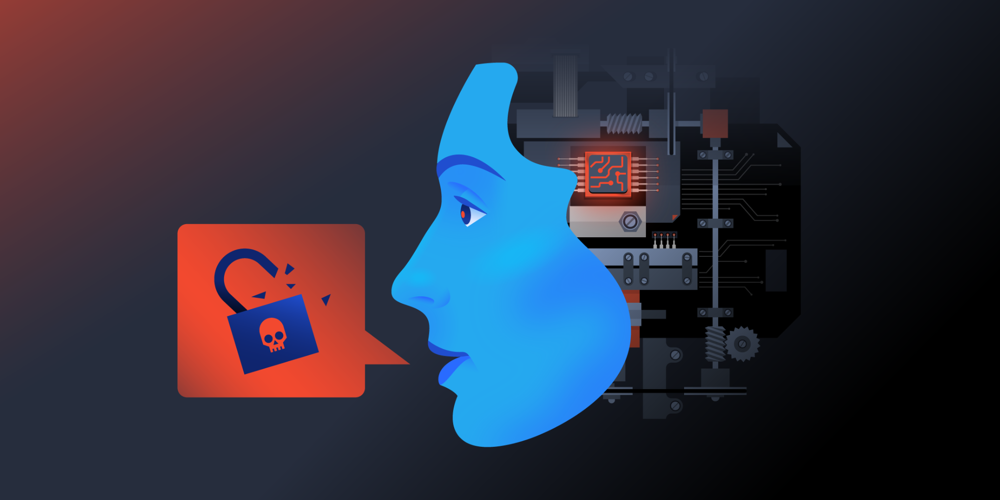


https://www.toptal.com/insights/innovation/voice-clone

**Background:**


We are a technology company working in the Cyber Security industry. We focus on building systems that help individuals and organizations to have safe and secure digital presence by providing cutting edge technologies to our customers. We create products and services that ensure our customers security using data driven technologies to understand whether audio and video media is authentic or fake.


The goal of this project is to build algorithms that can synthesize spoken audio by converting a speaker’s voice to another speaker’s voice with the end goal to detect if any spoken audio is pristine or fake.


**Data Description:**


There are two datasets we will utilize in this project. Both datasets are publicly available sources.


*TIMIT Dataset:*


The TIMIT corpus of read speech is designed to provide speech data for acoustic-phonetic studies and for the development and evaluation of automatic speech recognition systems. TIMIT contains a total of 6300 sentences, 10 sentences spoken by each of 630 speakers from 8 major dialect regions of the United States.


Dataset Link: https://github.com/philipperemy/timit


*CommonVoice Dataset:*


Common Voice is part of Mozilla's initiative to help teach machines how real people speak. Common Voice is a corpus of speech data read by users on the Common Voice website (https://commonvoice.mozilla.org/), and based upon text from a number of public domain sources like user submitted blog posts, old books, movies, and other public speech corpora. Its primary purpose is to enable the training and testing of automatic speech recognition (ASR) systems.


Dataset Link: https://commonvoice.mozilla.org/en/datasets



**Project Description:**


We will build a machine learning system to detect if a spoken audio is synthetically generated or not. In order to achieve this, first, a voice cloning system must be constructed given a speaker’s spoken audio that clones the source speaker’s voice to the target speaker’s voice. Next, a machine learning system must be constructed which detects if any spoken audio is a natural speech or synthetically generated by machine.


For the voice cloning system (VC), we will utilize the TIMIT dataset as it consists of aligned text-audio data with various speakers. For the fake audio detection system (FAD) we will utilize the CommonVoice dataset as it consists of thousands of naturally spoken audio which could be used as golden spoken audio by humans as positive examples and creating negative examples using the voice cloning system as automatic data/label generator. 





We will use Word Error Rate (WER) for automatic evaluation of the voice cloning (VC) system for the speech generation part and also report speaker classification accuracy to assess the performance of the generated audio’s target speaker. For the fake audio detection (FAD) system, we will evaluate the performance of the models using area under the ROC curve via positive labels coming from the groundtruth dataset and negative labels generated by the VC.



The code for importing the Real Time Voice Cloning files from Jemine Corentin was found [here](https://github.com/tugstugi/dl-colab-notebooks/blob/master/notebooks/RealTimeVoiceCloning.ipynb). This is a colab demo notebook using the open source project [CorentinJ/Real-Time-Voice-Cloning](https://github.com/CorentinJ/Real-Time-Voice-Cloning) to clone a voice.  This was integral in importing the appropriate versions for the synthesizer, encoder and vocoder.

In [2]:
%%capture
import os
from os.path import exists, basename, splitext

git_repo_url = 'https://github.com/CorentinJ/Real-Time-Voice-Cloning.git'
project_name = splitext(basename(git_repo_url))[0]

# clone and install
!git clone -q --recursive {git_repo_url}
# install dependencies
!cd {project_name} && pip install -q -r requirements.txt
!pip install -q --upgrade gdown
!apt-get install -qq libportaudio2
!pip install -q https://github.com/tugstugi/dl-colab-notebooks/archive/colab_utils.zip

# download pretrained model
!cd {project_name} && mkdir -p saved_models/default/
!cd {project_name}/saved_models/default/ && gdown https://drive.google.com/uc?id=1q8mEGwCkFy23KZsinbuvdKAQLqNKbYf1
!cd {project_name}/saved_models/default/ && gdown https://drive.google.com/uc?id=1EqFMIbvxffxtjiVrtykroF6_mUh-5Z3s
!cd {project_name}/saved_models/default/ && gdown https://drive.google.com/uc?id=1cf2NO6FtI0jDuy8AV3Xgn6leO6dHjIgu

import sys
sys.path.append(project_name)

from IPython.display import display, Audio, clear_output
from IPython.utils import io
import ipywidgets as widgets
import numpy as np
from dl_colab_notebooks.audio import record_audio, upload_audio

from synthesizer.inference import Synthesizer
from encoder import inference as encoder
from vocoder import inference as vocoder
from pathlib import Path

In [4]:
encoder.load_model(project_name / Path("saved_models/default/encoder.pt"))
synthesizer = Synthesizer(project_name / Path("saved_models/default/synthesizer.pt"))
vocoder.load_model(project_name / Path("saved_models/default/vocoder.pt"))

Loaded encoder "encoder.pt" trained to step 1564501
Synthesizer using device: cpu
Building Wave-RNN
Trainable Parameters: 4.481M
Loading model weights at Real-Time-Voice-Cloning/saved_models/default/vocoder.pt


In [3]:
%%capture
!pip install wavio
!pip install noisereduce
!pip install speechrecognition
!pip install spacy
!pip install moviepy
!sudo pip3 install imageio==2.4.1
!python -m spacy download en_core_web_sm

In [2]:
import wavio
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import spacy
import random
import noisereduce as nr
import speech_recognition as sr
import shutil
import librosa
from librosa.feature.spectral import tonnetz

from scipy.io import wavfile
from moviepy.editor import concatenate_audioclips, AudioFileClip

import warnings
warnings.filterwarnings("ignore")


import tensorflow as tf
from tensorflow import keras
from keras import layers
from keras.layers import Flatten, Dense
from keras.models import Sequential
from keras.optimizers import adam_v2

Imageio: 'ffmpeg-linux64-v3.3.1' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg-linux64-v3.3.1 (43.8 MB)
Downloading: 8192/45929032 bytes (0.0%)1925120/45929032 bytes (4.2%)4235264/45929032 bytes (9.2%)6594560/45929032 bytes (14.4%)8912896/45929032 bytes (19.4%)11255808/45929032 bytes (24.5%)13869056/45929032 bytes (30.2%)16162816/45929032 bytes (35.2%)18784256/45929032 bytes (40.9%)21135360/45929032 bytes (46.0%)23560192/45929032 bytes (51.3%)26435584/45929032 bytes (57.6%)28966912/45929032 bytes (63.1%)316

###**Audio file manipulation**

We will now import the TIMIT corpus and use it to clone voices.  

In [6]:
%%capture
!unzip "/content/drive/MyDrive/archive.zip"

We will take a look at the training csv file to ensure that it was imported correctly.

In [7]:
train = pd.read_csv("/content/train_data.csv")
train.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TRAIN,DR4,MMDM0,SI681.WAV.wav,TRAIN/DR4/MMDM0/SI681.WAV.wav,TRAIN\\DR4\\MMDM0\\SI681.WAV.wav,True,True,False,False,False
1,2.0,TRAIN,DR4,MMDM0,SI1311.PHN,TRAIN/DR4/MMDM0/SI1311.PHN,TRAIN\\DR4\\MMDM0\\SI1311.PHN,False,False,False,True,False
2,3.0,TRAIN,DR4,MMDM0,SI1311.WRD,TRAIN/DR4/MMDM0/SI1311.WRD,TRAIN\\DR4\\MMDM0\\SI1311.WRD,False,False,True,False,False
3,4.0,TRAIN,DR4,MMDM0,SX321.PHN,TRAIN/DR4/MMDM0/SX321.PHN,TRAIN\\DR4\\MMDM0\\SX321.PHN,False,False,False,True,False
4,5.0,TRAIN,DR4,MMDM0,SX321.WRD,TRAIN/DR4/MMDM0/SX321.WRD,TRAIN\\DR4\\MMDM0\\SX321.WRD,False,False,True,False,False


Next, we will define a synthesize function utilizing the encoder, vocoder and synthesizer we imported earlier. A voice encoder is a high-level representation of a voice through a deep learning model. Given an audio file of speech, it creates a summary vector of 256 values that summarizes the characteristics of the voice spoken.  The synthesizer takes in the sequence of distinct units of a sound of words as inputs and generates a spectrogram of the corresponding text input.  The vocoder converts the spectrogram into an audio waveform.  

In [8]:
def synthesize(audio, text, audio_name):
  
  embedding = encoder.embed_utterance(encoder.preprocess_wav(audio, 22050))
  print("Synthesizing new audio...")
  specs = synthesizer.synthesize_spectrograms([text], [embedding])
  generated_wav = vocoder.infer_waveform(specs[0])
  generated_wav = np.pad(generated_wav, (1, synthesizer.sample_rate), mode="constant")
  clear_output()
  wavio.write(audio_name, generated_wav, sampwidth=2, rate=synthesizer.sample_rate)

We will now initialize the speech recognition recognizer and define a speech to text function. This function will return the text from the cloned audio, load the audio to memory and convert speech to text.  

In [9]:
r = sr.Recognizer()

def speech_to_text(audio):
  
  with sr.AudioFile(audio) as source:
      audio_data = r.record(source)
      text = r.recognize_google(audio_data)
      return text

Next, we will utilize the spacy package inside of a text comparison function that comprises our speech to text function above to compare some selected text with natural language processing (nlp) to text from the audio.  This will provide us with our word error rate (WER).

In [10]:
nlp = spacy.load('en_core_web_sm')
def text_comparison(audio, text, nlp = nlp):
 
  new_text = speech_to_text(audio)
  original_text = nlp(text)
  return original_text.similarity(nlp(new_text))

To test out our latest functions and clone voice, I will use lyrics from the Smashing Pumpkins song "thirty-three" (Corgan) and compare the text to the cloned voices.  

In [11]:
text = "mysteries not ready to reveal your sympathies I am ready to return"

The below audio are actual audio files from the TIMIT corpus.

In [12]:
audio_1 = '/content/data/TRAIN/DR1/FCJF0/SA1.WAV.wav'
Audio(audio_1, autoplay=True)

In [13]:
audio_2 = '/content/data/TRAIN/DR6/MTXS0/SA2.WAV.wav'
Audio(audio_2, autoplay=True)

In [14]:
audio_3 = '/content/data/TRAIN/DR7/FJEN0/SA2.WAV.wav'
Audio(audio_3, autoplay=True)

Now, we will implement our synthesize function to create wav files.

In [ ]:
synthesize(audio_1, text, 'sound-1.wav')
synthesize(audio_2, text, 'sound-2.wav')
synthesize(audio_3, text, 'sound-3.wav')

In [16]:
Audio("sound-1.wav", autoplay=True)

This file is very "choppy" or has a large amount of noise.

In [ ]:
Audio("sound-2.wav", autoplay=True)

This file is a little better but still a fair amount of noise.

In [ ]:
Audio("sound-3.wav", autoplay=True)

This is a wonderful recording as the female voice sounds as if she is genuinely stating the sentiment.  As stated above, the text comparision function will now produce our WER in the form of a similarity score.

In [ ]:
text_1_score = text_comparison("sound-1.wav", text)
text_2_score = text_comparison("sound-2.wav", text)
text_3_score = text_comparison("sound-3.wav", text)

In [ ]:
print(f"First audio score is: {text_1_score}")
print(f"Second audio score is: {text_2_score}")
print(f"Third audio score is: {text_3_score}")

First audio score is: 0.9908579718791012
Second audio score is: 0.744207071231886
Third audio score is: 0.9249256717889695


These similarity scores are very high here!  This is a positive result because this is an indicator that a predictive model will be able to decipher the files well enough to perform well.

In [ ]:
train.path_from_data_dir = [f"data/{i}" for i in train.path_from_data_dir]

Next, we will create a dictionary with unique speaker_id as a key for the dictionary.

In [ ]:
speaker_id_dic = {}
for i in train.speaker_id.unique():
  speaker_id_dic[i] = []

Next, we will take all of the audio files for each speaker and add it as a value of each key.

In [ ]:
for i in range(train.shape[0]):
  for key, value in speaker_id_dic.items():
    if train.speaker_id[i] == key:
      if train.path_from_data_dir[i].endswith('.wav'):
        value.append(train.path_from_data_dir[i])

It is possible that if we concatenate several of the audio files together and use it for training that it will train better and be more accurate on a test set.  We will do that with the long audio function below.

In [ ]:
def long_audio(files, file_name):
  clips = [AudioFileClip(c) for c in files]
  final_clip = concatenate_audioclips(clips)
  final_clip.write_audiofile(file_name)

We will now apply the long audio function on a sample speaker to convert the short audio files into one file.

In [ ]:
long_audio(speaker_id_dic["MWGR0"], "long-audio-1.wav")
long_audio(speaker_id_dic["MWDK0"], "long-audio-2.wav")
long_audio(speaker_id_dic["MTWH1"], "long-audio-3.wav")

[MoviePy] Writing audio in long-audio-1.wav


100%|██████████| 631/631 [00:00<00:00, 2544.54it/s]

[MoviePy] Done.


[MoviePy] Writing audio in long-audio-2.wav


100%|██████████| 661/661 [00:00<00:00, 1178.15it/s]

[MoviePy] Done.


[MoviePy] Writing audio in long-audio-3.wav


100%|██████████| 584/584 [00:00<00:00, 2629.29it/s]

[MoviePy] Done.


In [ ]:
audio_4 = "long-audio-1.wav"
Audio(audio_4, autoplay=True)

In [ ]:
audio_5 = "long-audio-2.wav"
Audio(audio_5, autoplay=True)

In [ ]:
audio_6 = "long-audio-3.wav"
Audio(audio_6, autoplay=True)

In [ ]:
synthesize(audio_4, text, "audio-4.wav")
synthesize(audio_5, text, "audio-5.wav")
synthesize(audio_6, text, "audio-6.wav")

In [ ]:
Audio("audio-4.wav", autoplay=True)

In [ ]:
Audio("audio-5.wav", autoplay=True)

In [ ]:
Audio("audio-6.wav", autoplay=True)

All of these longer files sound clear with minimal noise this time.

In [ ]:
text_4_score = text_comparison("audio-4.wav", text)
text_5_score = text_comparison("audio-5.wav", text)
text_6_score = text_comparison("audio-6.wav", text)

In [ ]:
print(f"First audio score is:  {text_4_score}")
print(f"Second audio score is: {text_5_score}")
print(f"Third audio score is:  {text_6_score}")

First audio score is:  0.9908579718791012
Second audio score is: 0.9908579718791012
Third audio score is:  0.8528983667666625


We can see that our similarity scores are even higher than they were before using longer audio files. Let's compare the training and test datasets.

In [ ]:
train = pd.read_csv("/content/train_data.csv")
test = pd.read_csv("/content/test_data.csv")

In [ ]:
train.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TRAIN,DR4,MMDM0,SI681.WAV.wav,TRAIN/DR4/MMDM0/SI681.WAV.wav,TRAIN\\DR4\\MMDM0\\SI681.WAV.wav,True,True,False,False,False
1,2.0,TRAIN,DR4,MMDM0,SI1311.PHN,TRAIN/DR4/MMDM0/SI1311.PHN,TRAIN\\DR4\\MMDM0\\SI1311.PHN,False,False,False,True,False
2,3.0,TRAIN,DR4,MMDM0,SI1311.WRD,TRAIN/DR4/MMDM0/SI1311.WRD,TRAIN\\DR4\\MMDM0\\SI1311.WRD,False,False,True,False,False
3,4.0,TRAIN,DR4,MMDM0,SX321.PHN,TRAIN/DR4/MMDM0/SX321.PHN,TRAIN\\DR4\\MMDM0\\SX321.PHN,False,False,False,True,False
4,5.0,TRAIN,DR4,MMDM0,SX321.WRD,TRAIN/DR4/MMDM0/SX321.WRD,TRAIN\\DR4\\MMDM0\\SX321.WRD,False,False,True,False,False


In [ ]:
test.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TEST,DR4,MGMM0,SX139.WAV,TEST/DR4/MGMM0/SX139.WAV,TEST\\DR4\\MGMM0\\SX139.WAV,False,True,False,False,False
1,2.0,TEST,DR4,MGMM0,SX139.WAV.wav,TEST/DR4/MGMM0/SX139.WAV.wav,TEST\\DR4\\MGMM0\\SX139.WAV.wav,True,True,False,False,False
2,3.0,TEST,DR4,MGMM0,SX139.TXT,TEST/DR4/MGMM0/SX139.TXT,TEST\\DR4\\MGMM0\\SX139.TXT,False,False,False,False,True
3,4.0,TEST,DR4,MGMM0,SI499.WRD,TEST/DR4/MGMM0/SI499.WRD,TEST\\DR4\\MGMM0\\SI499.WRD,False,False,True,False,False
4,5.0,TEST,DR4,MGMM0,SX319.WRD,TEST/DR4/MGMM0/SX319.WRD,TEST\\DR4\\MGMM0\\SX319.WRD,False,False,True,False,False


In [ ]:
train = train.dropna()
test = test.dropna()
train.shape, test.shape

((8400, 12), (8400, 12))

In [ ]:
train.path_from_data_dir = [f"data/{i}" for i in train.path_from_data_dir]
test.path_from_data_dir  = [f"data/{i}" for i in test.path_from_data_dir ]

In [ ]:
train.speaker_id.nunique()

168

In [ ]:
test.speaker_id.nunique()

168

We will concatenate the train and test files together and reset the index.

In [ ]:
df = pd.concat([train, test], axis=0)
df.head()

,index,test_or_train,dialect_region,speaker_id,filename,path_from_data_dir,path_from_data_dir_windows,is_converted_audio,is_audio,is_word_file,is_phonetic_file,is_sentence_file
0,1.0,TRAIN,DR4,MMDM0,SI681.WAV.wav,data/TRAIN/DR4/MMDM0/SI681.WAV.wav,TRAIN\\DR4\\MMDM0\\SI681.WAV.wav,True,True,False,False,False
1,2.0,TRAIN,DR4,MMDM0,SI1311.PHN,data/TRAIN/DR4/MMDM0/SI1311.PHN,TRAIN\\DR4\\MMDM0\\SI1311.PHN,False,False,False,True,False
2,3.0,TRAIN,DR4,MMDM0,SI1311.WRD,data/TRAIN/DR4/MMDM0/SI1311.WRD,TRAIN\\DR4\\MMDM0\\SI1311.WRD,False,False,True,False,False
3,4.0,TRAIN,DR4,MMDM0,SX321.PHN,data/TRAIN/DR4/MMDM0/SX321.PHN,TRAIN\\DR4\\MMDM0\\SX321.PHN,False,False,False,True,False
4,5.0,TRAIN,DR4,MMDM0,SX321.WRD,data/TRAIN/DR4/MMDM0/SX321.WRD,TRAIN\\DR4\\MMDM0\\SX321.WRD,False,False,True,False,False


In [ ]:
df = df.reset_index(drop = True)

Now, we will create a dictionary for all of the speakers.

In [ ]:
speaker_id_dic  = {}
for i in df.speaker_id.unique():
  speaker_id_dic[i] = []

Now, we will add the audio files to the value part of key value pairs.

In [ ]:
for i in range(df.shape[0]):
  for key, value in speaker_id_dic.items():
    if df.speaker_id[i] == key:
      if df.path_from_data_dir[i].endswith(".wav"):
        value.append(df.path_from_data_dir[i])

We will again convert the short audio files to long ones for all of the audio files and write to an audio folder.

In [ ]:
%%capture
for key, value in speaker_id_dic.items():
  files = speaker_id_dic[key]
  clips = [AudioFileClip(c) for c in files]
  final_clip = concatenate_audioclips(clips)
  final_clip.write_audiofile(f"/content/drive/MyDrive/audio/{key}.wav")

In [ ]:
df.speaker_id.nunique()

336

There are 336 unique speakers in the dataset.  We will now take all of the text files and add them to a list called "text list."

In [ ]:
text_files = [i for i in df.path_from_data_dir if i.endswith("TXT")]

In [ ]:
text_list = []
for file in text_files:
  with open(file) as f:
    lines = f.readlines()
    text_list.append(lines)

We will now split the text at the occurrence of a space and return the text to join the text and remove certain special characters.

In [ ]:
final_text = []
for i in range(len(text_list)):
  text = text_list[i][0].split(" ")[2:]
  text = " ".join(text)
  text = text.replace("\n", "").replace(".", "").replace("?", "").replace("!", "")
  final_text.append(text)

In [ ]:
len(set(final_text))

1456

Now, we will start constructing a dataframe that we can implement into a neural network.

In [ ]:
audio_files = [f"/content/drive/MyDrive/audio/{audio}" for audio in os.listdir("/content/drive/MyDrive/audio")]

In [ ]:
audio_files[:4]

['/content/drive/MyDrive/audio/MMDM0.wav',
 '/content/drive/MyDrive/audio/MCSS0.wav',
 '/content/drive/MyDrive/audio/MCDR0.wav',
 '/content/drive/MyDrive/audio/MLEL0.wav']

It appears as if the audio files are now in a variable called "audio files."  Let's extract the name of the file and place it in a column in a cloned dataframe.

In [ ]:
audio_name = [i for i in os.listdir("/content/drive/MyDrive/audio")]
audio_name[:4]

['MMDM0.wav', 'MCSS0.wav', 'MCDR0.wav', 'MLEL0.wav']

In [ ]:
cloned_df = pd.DataFrame(audio_name, columns=["file"])

In [ ]:
cloned_df["text"] = None
cloned_df.head()

,file,text
0,MMDM0.wav,None
1,MCSS0.wav,None
2,MCDR0.wav,None
3,MLEL0.wav,None
4,FEEH0.wav,None


The below for loop will randomly shuffle the final text list as a field in our cloned dataframe.

In [ ]:
for i in range(cloned_df.shape[0]):
  cloned_df["text"][i] = f"{random.choice(list(set(final_text)))}"

cloned_df.head()

,file,text
0,MMDM0.wav,It may be hard to decide what this labor is wo...
1,MCSS0.wav,We have nothing to hide under a bushel
2,MCDR0.wav,Just drop notices in any suggestion box
3,MLEL0.wav,Look for these features which may mean you can...
4,FEEH0.wav,That brings its per-year cost down mighty low


Now, we will create a csv file using our cloned dataframe.

In [ ]:
cloned_df.to_csv("cloned_df.csv")

Now, we will feed the model with the long audio files and write a random text.

In [ ]:
counter = 1
for i in range(cloned_df.shape[0]):
  text = cloned_df.text[i]
  synthesize(audio_files[i], text, f'/content/drive/MyDrive/synthesized_audio/{cloned_df.file[i]}')
  print(f"{counter} files have been cloned out of 336")
  counter += 1

336 files have been cloned out of 336


This cell took over 3 hours to run!  Now, we will import the common voice dataset described in the project description.

In [ ]:
%%capture
!unzip "/content/drive/MyDrive/commonVoice.zip"

We will now print the files list, iterate over all random files and move them to the real audio folder.  These files from the common voice dataset will be placed into a dataframe called "real_df." Our "fake" audio that has been syntehsized will be combined with the real audio to train a neural network model that will attempt to predict which files are real and which are fake with a validation or test set.

In [ ]:
files_list = []

for root, dirs, files in os.walk("/content/cv-other-test"):
  for file in files:
    if file.endswith(".mp3"):
      files_list.append(os.path.join(root, file))
  
filesToCopy = random.sample(files_list, 400)  
destPath ="/content/drive/MyDrive/real_audio"

for file in filesToCopy:
    shutil.move(file, destPath)

###**Real audio data vs. Cloned audio data**

####**Fake audio**

We will now list the files in the synthesized audio folder, put them into a pandas dataframe and rename the first column name to file exactly like we did before.  The same process will be performed on the real audio from the common voice dataset.

In [ ]:
fake_files_list = os.listdir("/content/drive/MyDrive/synthesized_audio")
fake_df = pd.DataFrame(fake_files_list)
fake_df = fake_df.rename(columns = {0:"file"})
fake_df["real"] = 0
fake_df.file  = [f"/content/drive/MyDrive/synthesized_audio/{i}" for i in fake_df.file]
fake_df.head()

,file,real
0,/content/drive/MyDrive/synthesized_audio/MMDM0...,0
1,/content/drive/MyDrive/synthesized_audio/MCSS0...,0
2,/content/drive/MyDrive/synthesized_audio/MCDR0...,0
3,/content/drive/MyDrive/synthesized_audio/MLEL0...,0
4,/content/drive/MyDrive/synthesized_audio/FEEH0...,0


####**Real audio**

In [ ]:
#list the files
real_file_list = os.listdir("/content/drive/MyDrive/real_audio") 
#read them into pandas
real_df = pd.DataFrame(real_file_list)
# Renaming the column name to file
real_df = real_df.rename(columns={0:'file'})
real_df['real'] = 1
real_df.file = [f"/content/drive/MyDrive/real_audio/{i}" for i in real_df.file]
real_df.head(2)

,file,real
0,/content/drive/MyDrive/real_audio/sample-00287...,1
1,/content/drive/MyDrive/real_audio/sample-00006...,1


####**Audio file modeling with a Keras neural network**

In [ ]:
real_df.shape, fake_df.shape

((400, 2), (336, 2))

The real and fake dataframes are similar in size.  We want to combine these dataframes into one so that we can predict on them with a neural network model and develop a model that can be utilized in "the wild" to predict whether audio id a real human voice or a fake human voice that has been cloned. 

In [ ]:
df = pd.concat([real_df, fake_df], axis=0)
df.head()

,file,real
0,/content/drive/MyDrive/real_audio/sample-00287...,1
1,/content/drive/MyDrive/real_audio/sample-00006...,1
2,/content/drive/MyDrive/real_audio/sample-00249...,1
3,/content/drive/MyDrive/real_audio/sample-00010...,1
4,/content/drive/MyDrive/real_audio/sample-00126...,1


In [ ]:
df = df.sample(frac=1).reset_index(drop=True)

Now, we will split the data into training, validation and test sets.  The validation and test sets will be 10% so that we hope to have enough data to train on.  

In [ ]:
X = df[["file"]]
y = df.real
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42, shuffle=True)

In [ ]:
print(f"X_train length is : {len(X_train)}, y_train length is: {len(y_train)}")
print(f"X_test length is : {len(X_test)}, y_train length is: {len(y_test)}")
print(f"X_train length is : {len(X_val)}, y_train length is: {len(y_val)}")

X_train length is : 595, y_train length is: 595
X_test length is : 74, y_train length is: 74
X_train length is : 67, y_train length is: 67


The first step in any automatic speech recognition system is to extract features or identify the components of the audio signal that are good for identifying the linguistic content and discarding all the other stuff which carries information like background noise, emotion etc.

In order to accomplish this, we will create a function to extract the Mel-frequency cepstral coefficients (MFCCs), a chromagram from a power spectrogram, a mel-scaled spectrogram, spectral contrast and tonal centroid features for each audio file with the librosa package.  The function will load the audio file as a floating point time series and assign the sample rate which is set to 22050 by default.

Mel Frequency Cepstral Coefficents (MFCCs) is a feature widely used in automatic speech and speaker recognition. The shape of the vocal tract manifests itself in the envelope of the short time power spectrum, and the job of MFCCs is to accurately represent this envelope. Mel Frequency Cepstral Coefficents (MFCCs) is a way of extracting features from an audio file. The MFCC uses the MEL scale to divide the frequency band to sub-bands and then extracts the Cepstral Coefficents using Discrete Cosine Transform (DCT). MEL scale is based on the way humans distinguish between frequencies which makes it very convenient to process sounds.

The Chroma filters can be derived from the Chroma filter bank. The filter bank aims to project all the energy of the recorded sound into 12 bins.  These features would be very useful as they would tell the neural network how the pitch would likely change over time.  By taking the dot product of our Fourier based spectrogram by taking the short-time Fourier transform (STFT), and this filter bank, we can then map the audio in question onto the set of pitches.

The Mel scale relates perceived frequency, or pitch, of a pure tone to its actual measured frequency. Humans are much better at discerning small changes in pitch at low frequencies than they are at high frequencies. Incorporating this scale makes our features match more closely what humans hear.

Spectral contrast is defined as the decibel dif- ference between peaks and valleys in the spectrum.  Each frame of a spectrogram S is divided into sub-bands. For each sub-band, the energy contrast is estimated by comparing the mean energy in the top quantile (peak energy) to that of the bottom quantile (valley energy). High contrast values generally correspond to clear, narrow-band signals, while low contrast values correspond to broad-band noise.

The “central” tones or "tonnetz" features are features that help in detecting harmonic change or variances due to tones in audio.

Each mfcc is an array of length 40, chroma is 12, mel is 128, contrast is 7 and tonnetz is 6. Overall we have 193 numerical features for each voice clip from the audio features we have chosen.

In [ ]:
def extract_features(files):
  df = {'mfccs' : [], 'chroma' : [], 'mel' : [], 'contrast' : [], 'tonnetz' : []}
  for file_name in files:
    X, sample_rate = librosa.load(file_name, res_type='kaiser_fast')
    # Generate Mel-frequency cepstral coefficients (MFCCs) from a time series 
    mfccs = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40).T,axis=0)
    df['mfccs'].append(mfccs)
    # Generate a Short-time Fourier transform (STFT) to use in the chroma_stft
    stft = np.abs(librosa.stft(X))
    # Compute a chromagram from a waveform or power spectrogram.
    chroma = np.mean(librosa.feature.chroma_stft(S=stft, sr=sample_rate).T,axis=0)
    df['chroma'].append(chroma)
    # Compute a mel-scaled spectrogram.
    mel = np.mean(librosa.feature.melspectrogram(X, sr=sample_rate).T,axis=0)
    df['mel'].append(mel)
    # Compute spectral contrast
    contrast = np.mean(librosa.feature.spectral_contrast(S=stft, sr=sample_rate).T,axis=0)
    df['contrast'].append(contrast)
    # Compute the tonal centroid features (tonnetz)
    tonnetz = np.mean(librosa.feature.tonnetz(y=librosa.effects.harmonic(X), sr=sample_rate).T,axis=0)
    df['tonnetz'].append(tonnetz)
  return df

In [ ]:
val_features = extract_features(X_val.file)
train_features = extract_features(X_train.file)
test_features = extract_features(X_test.file)

We will now scale the data with the Standard Scaler function and create a function that will concatenate all of those numerical features for each file so that we have a single array of 193 numbers for each file to feed into a neural network.

In [ ]:
scaler = StandardScaler()


def concat_features(features):
  features_list = []
  for i in range(0, len(features["mfccs"])):
    features_list.append(np.concatenate((
        scaler.fit_transform((features["mfccs"][i]).reshape(-1,1)),
        scaler.fit_transform((features["chroma"][i]).reshape(-1,1)),
        scaler.fit_transform((features["mel"][i]).reshape(-1,1)),
        scaler.fit_transform((features["contrast"][i]).reshape(-1,1)),
        scaler.fit_transform((features["tonnetz"][i]).reshape(-1,1))), axis=0))
  return np.array(features_list).reshape(len(features["mfccs"]), 193)

In [ ]:
X_val_data   = concat_features(val_features)
X_train_data = concat_features(train_features)
X_test_data  = concat_features(test_features)

In [ ]:
y_train = np.array(y_train)
y_test  = np.array(y_test)
y_val   = np.array(y_val)

Now, we should be ready for modeling.  We will utilize a simple feed forward sequential neural network model with dense layers suitable for audio files and observe the performance.  Of course, the Adam optimizer will be utilized with area under the ROC curve for metrics.  Early stopping will also be employed to avoid overfitting the data.

In [ ]:
model_1 = Sequential() 

model_1.add(Dense(64, input_shape=(193,), kernel_initializer = 'he_uniform', 
   kernel_regularizer = None, kernel_constraint = 'MaxNorm', activation = 'relu')) 
model_1.add(Dense(32, activation = 'relu')) 
model_1.add(Dense(1, activation = 'sigmoid'))

opt = adam_v2.Adam(lr=0.001)


model_1.compile(loss='binary_crossentropy',
                optimizer=opt,
                metrics=[tf.keras.metrics.AUC()])


early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, verbose=0)

In [ ]:
hist_1 = model_1.fit(X_train_data, y_train, validation_data=(X_val_data, y_val), epochs=1000, callbacks=[early_stop])

Epoch 1/1000
19/19 [==============================] - 2s 18ms/step - loss: 0.4609 - auc: 0.8855 - val_loss: 0.3066 - val_auc: 0.9483
Epoch 2/1000
19/19 [==============================] - 0s 4ms/step - loss: 0.2504 - auc: 0.9673 - val_loss: 0.2273 - val_auc: 0.9689
Epoch 3/1000
19/19 [==============================] - 0s 4ms/step - loss: 0.1838 - auc: 0.9813 - val_loss: 0.1893 - val_auc: 0.9808
Epoch 4/1000
19/19 [==============================] - 0s 5ms/step - loss: 0.1439 - auc: 0.9895 - val_loss: 0.1702 - val_auc: 0.9844
Epoch 5/1000
19/19 [==============================] - 0s 5ms/step - loss: 0.1250 - auc: 0.9917 - val_loss: 0.1356 - val_auc: 0.9863
Epoch 6/1000
19/19 [==============================] - 0s 6ms/step - loss: 0.1065 - auc: 0.9952 - val_loss: 0.1341 - val_auc: 0.9927
Epoch 7/1000
19/19 [==============================] - 0s 3ms/step - loss: 0.0775 - auc: 0.9980 - val_loss: 0.1346 - val_auc: 0.9899
Epoch 8/1000
19/19 [==============================] - 0s 3ms/step - loss: 0

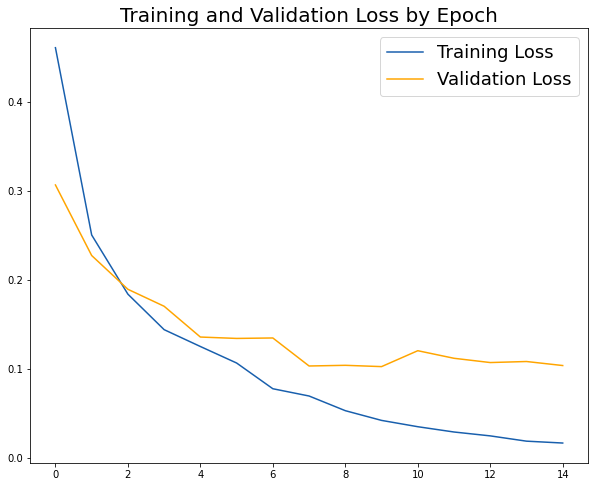

In [ ]:
plt.figure(figsize=(10, 8))
plt.plot(hist_1.history['loss'], label='Training Loss', color='blue')
plt.plot(hist_1.history['val_loss'], label='Validation Loss', color='orange')
plt.title('Training and Validation Loss by Epoch', fontsize = 20)
plt.legend(fontsize = 18);

3/3 [==============================] - 0s 4ms/step - loss: 0.0651 - auc: 1.0000
Test evaluation [0.06511709839105606, 1.0]
3/3 [==============================] - 0s 4ms/step


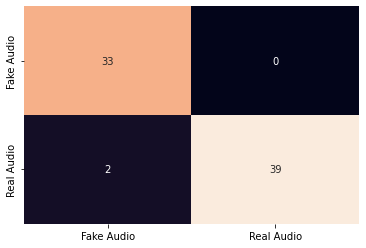

In [ ]:
print("Test evaluation", model_1.evaluate(X_test_data, y_test))
cm = confusion_matrix(y_test, y_pred = tf.round(model_1.predict(X_test_data)))
ax = sns.heatmap(cm, annot=True, cbar=False)

ax.xaxis.set_ticklabels(["Fake Audio", "Real Audio"])
ax.yaxis.set_ticklabels(["Fake Audio", "Real Audio"])

plt.show()

Early stopping helped produce a robust predictive model as the validation loss did not improve after only 15 epochs.  The neural network only misclassified two audio files and the area under the curve is perfect!  This was without removing the noise in the audio files, however.  How will our model perform when the noise is removed?

###**Real audio data vs. Cloned audio data with removing the noise**

We will now take the synthesized audio and remove the noise from it.

In [ ]:
for file in os.listdir('/content/drive/MyDrive/synthesized_audio'):
  
  rate, data = wavfile.read(f'/content/drive/MyDrive/synthesized_audio/{file}')
  
  reduced_noise = nr.reduce_noise(y=data, sr=rate)
  wavfile.write(f"/content/drive/MyDrive/synthesized_audio_without_noise/{file}", rate, reduced_noise)

Now, we will list the noise-reduced files, read them into a dataframe for modeling and rename the column to be similar to the previous dataframe.

In [ ]:

fake_file_list_without_noise = os.listdir('/content/drive/MyDrive/synthesized_audio_without_noise') 

fake_df_without_noise = pd.DataFrame(fake_file_list_without_noise)

fake_df_without_noise = fake_df_without_noise.rename(columns={0:'file'})
fake_df_without_noise['real'] = 0
fake_df_without_noise.file = [f"/content/drive/MyDrive/synthesized_audio_without_noise/{i}" for i in fake_df_without_noise.file]
fake_df_without_noise.head(2)

,file,real
0,/content/drive/MyDrive/synthesized_audio_witho...,0
1,/content/drive/MyDrive/synthesized_audio_witho...,0


We will then combine the real and fake dataframes as we did before any noise reduction and split it into training, validation and test sets.

In [ ]:
df_without_noise = pd.concat([real_df, fake_df_without_noise], axis=0)
df_without_noise = df_without_noise.sample(frac=1).reset_index(drop=True)
df_without_noise.head(2)

,file,real
0,/content/drive/MyDrive/synthesized_audio_witho...,0
1,/content/drive/MyDrive/real_audio/sample-00140...,1


In [ ]:
X = df_without_noise[['file']]
y = df_without_noise.real
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42, shuffle=True)

In [ ]:
print(f"X_train length is: {len(X_train)}, y_train length is: {len(y_train)}")
print(f"X_test length is: {len(X_test)}, y_test length is: {len(y_test)}")
print(f"X_val length is: {len(X_val)}, y_val length is: {len(y_val)}")

X_train length is: 595, y_train length is: 595
X_test length is: 74, y_test length is: 74
X_val length is: 67, y_val length is: 67


In [ ]:
val_features = extract_features(X_val.file)
train_features = extract_features(X_train.file)
test_features = extract_features(X_test.file)

In [ ]:
X_val_data = concat_features(val_features)
X_train_data = concat_features(train_features)
X_test_data = concat_features(test_features)

Obvoiusly, this will be the same Keras neural network from model 1 so that we can realistically evaluate performance.

In [ ]:
model_2 = Sequential() 

model_2.add(Dense(64, input_shape=(193,), kernel_initializer = 'he_uniform', 
    kernel_constraint = 'MaxNorm', activation = 'relu')) 
model_2.add(Dense(32, activation = 'relu')) 
model_2.add(Dense(1, activation = 'sigmoid'))

opt = adam_v2.Adam(lr=0.000001)

model_2.compile(loss='binary_crossentropy',
                optimizer=opt,
                metrics=[tf.keras.metrics.AUC()])

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=2, verbose=0)



In [ ]:
%%capture
hist_2 = model_2.fit(X_train_data, y_train, validation_data=(X_val_data, y_val), epochs=1000, callbacks=[early_stop])

Epoch 1/1000
19/19 [==============================] - 0s 4ms/step - loss: 0.3936 - auc_2: 0.9351 - val_loss: 0.4154 - val_auc_2: 0.9149
Epoch 2/1000
19/19 [==============================] - 0s 2ms/step - loss: 0.3933 - auc_2: 0.9353 - val_loss: 0.4150 - val_auc_2: 0.9144
Epoch 3/1000
19/19 [==============================] - 0s 2ms/step - loss: 0.3929 - auc_2: 0.9356 - val_loss: 0.4147 - val_auc_2: 0.9144
Epoch 4/1000
19/19 [==============================] - 0s 3ms/step - loss: 0.3926 - auc_2: 0.9358 - val_loss: 0.4144 - val_auc_2: 0.9149
Epoch 5/1000
19/19 [==============================] - 0s 3ms/step - loss: 0.3922 - auc_2: 0.9359 - val_loss: 0.4140 - val_auc_2: 0.9158
Epoch 6/1000
19/19 [==============================] - 0s 4ms/step - loss: 0.3918 - auc_2: 0.9361 - val_loss: 0.4137 - val_auc_2: 0.9158
Epoch 7/1000
19/19 [==============================] - 0s 3ms/step - loss: 0.3915 - auc_2: 0.9361 - val_loss: 0.4133 - val_auc_2: 0.9158
Epoch 8/1000
19/19 [============================

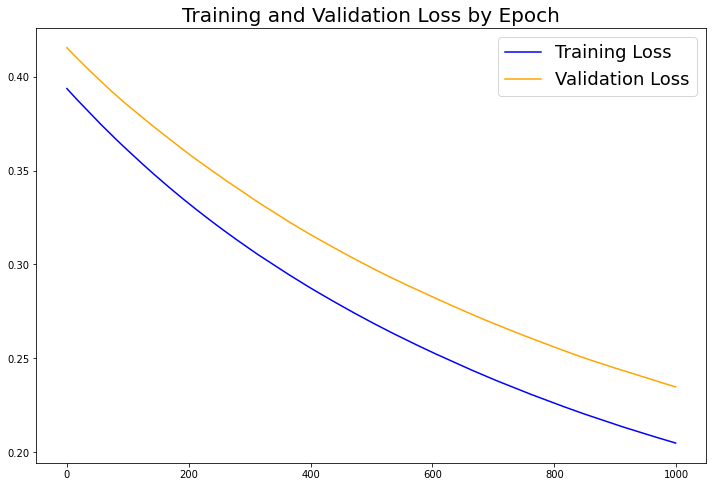

In [ ]:
plt.figure(figsize=(12, 8))
# Generate line plot of training, testing loss over epochs.
plt.plot(hist_2.history['loss'], label='Training Loss', color='blue')
plt.plot(hist_2.history['val_loss'], label='Validation Loss', color='orange')
plt.title('Training and Validation Loss by Epoch', fontsize = 20)
plt.legend(fontsize = 18)

3/3 [==============================] - 0s 2ms/step - loss: 0.1876 - auc_2: 0.9897
test evaluation [0.1876276582479477, 0.9897059202194214]
3/3 [==============================] - 0s 2ms/step


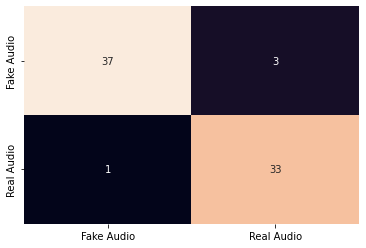

In [ ]:
print('test evaluation', model_2.evaluate(X_test_data, y_test))
cm = confusion_matrix(y_test, y_pred = tf.round(model_2.predict(X_test_data)))
ax = sns.heatmap(cm, annot=True, cbar=False)

ax.xaxis.set_ticklabels(['Fake Audio', 'Real Audio'])
ax.yaxis.set_ticklabels(['Fake Audio', 'Real Audio'])
plt.show()

###**Conclusion**

Early stopping did not help when the noise was removed from the audio files.  The training and validation loss did not converge after 1000 epochs although the validation loss was higher than the training loss.  Still, both losses were similar in value for all epochs so there is no evidence of underfitting or overfitting.  All features of the longer audio files were extracted and concatenated into a dataframe that could be introduced into a simple feed forward neural network for prediction of whether an audio file was cloned or from an authentic human voice.  Only four audio files were misclassified after removing the noise from them as model 1 and model 2 performed very well in predicting the presence of fake or cloned audio with model 1 having a perfect area under the ROC curve (AUC) and model 2 having a value close to 0.99 for the AUC.  It appears as if the presence of noise in audio files may actually be beneficial in predicting fake or cloned audio.  But, it is best to be robust and remove the noise in case this process is performed if potential fraud is being performed. WER was slightly higher when a longer audio file was constructed for prediction.